In [1]:
import os
import subprocess
import numpy as np
import pandas as pd

import statistics

def func_precision(stringList, answer):
    goal_count = 0
    found = 0

    for result in stringList:
        if result == str(answer):
            found = 1
        goal_count += 1
    return found/(goal_count-1)

def func_recall(stringList, answer):
    found = 0
    for result in stringList:
        if result == str(answer):
            found = 1
            break
    return found

def func_accuracy(total, stringList, answer):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    for result in stringList[0:-1]:
        if result == str(answer):
            tp += 1
        else:
            fp += 1
    
    fn = 1 - tp
    
    # total is the number of all goals
    tn = total - tp - fp - fn
    return (tp + tn)/(tn + tp + fp + fn)


def func_bacc(total, stringList, answer):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    for result in stringList[0:-1]:
        if result == str(answer):
            tp += 1
        else:
            fp += 1
    
    fn = 1 - tp
    
    # total is the number of all goals
    tn = total - tp - fp - fn

    tpr = tp/(tp + fn)
    tnr = tn/(tn + fp)
    bacc = (tpr + tnr)/2

    return bacc


# return a list of each statistics for every testing case
def calculate_statistics(rows):
    length = rows.shape[0]

    precision = []
    recall = []
    accuracy = []
    b_accuracy = []
        
    for index, row in rows.iterrows():
        
        answer = row["Real_Goal"]
        results = row["Results"].split("/")
        all_candidates = row["Cost"].split("/")
        
        total = len(all_candidates)-1   # the last one is /
        
        p = func_precision(results, answer)
        r = func_recall(results, answer)
        a = func_accuracy(total, results, answer)
        bacc = func_bacc(total, results, answer)
        
        precision.append(p)
        recall.append(r)
        accuracy.append(a)
        b_accuracy.append(bacc)
    
    return precision, recall, accuracy, b_accuracy


def averageMetricAllGoals(df, numGoals):
    length = df.shape[0]
    
    pointID = []
    countID = 0
    relearn = []

    precision = []
    recall = []
    accuracy = []
    b_accuracy = []
    
    std_p = []
    std_r = []
    std_a = []
    std_bacc = []

    tmp_precision = []
    tmp_recall = []
    tmp_accuracy = []
    tmp_b_accuracy = []
    
    tmp_relearn = False
        
    for index, row in df.iterrows():
        
        answer = row["Real_Goal"]
        results = row["Results"].split("/")
        all_candidates = row["Cost"].split("/")
        relearn_flag = row["Relearn"]
        
        total = len(all_candidates)-1   # the last one is /
        
        p = func_precision(results, answer)
        r = func_recall(results, answer)
        a = func_accuracy(total, results, answer)
        bacc = func_bacc(total, results, answer)

        tmp_precision.append(p)
        tmp_recall.append(r)
        tmp_accuracy.append(a)
        tmp_b_accuracy.append(bacc)
        
        if relearn_flag == "yes":
            tmp_relearn = True

        if len(tmp_b_accuracy) == numGoals:
            precision.append(statistics.mean(tmp_precision))
            recall.append(statistics.mean(tmp_recall))
            accuracy.append(statistics.mean(tmp_accuracy))
            b_accuracy.append(statistics.mean(tmp_b_accuracy))
            
            std_p.append(statistics.stdev(tmp_precision))
            std_r.append(statistics.stdev(tmp_recall))
            std_a.append(statistics.stdev(tmp_accuracy))
            std_bacc.append(statistics.stdev(tmp_b_accuracy))
            
            countID += 1
            pointID.append(countID)
            relearn.append(tmp_relearn)

            tmp_precision = []
            tmp_recall = []
            tmp_accuracy = []
            tmp_b_accuracy = []
            tmp_relearn = False
    
    return precision, recall, accuracy, b_accuracy, std_p, std_r, std_a, std_bacc, pointID, relearn





def moving_average(metric_list, shift_step, window_size):
    length = len(metric_list)
    index = 0 + window_size
    averages = []
    std = []
    timestamp = []
    while index <= length:
        sub_list = metric_list[(index - window_size) : index]
        averages.append(statistics.mean(sub_list))
        std.append(statistics.stdev(sub_list))
        timestamp.append(index)
        
        index += shift_step
    
    return averages, std, timestamp

### Codes for moving averages

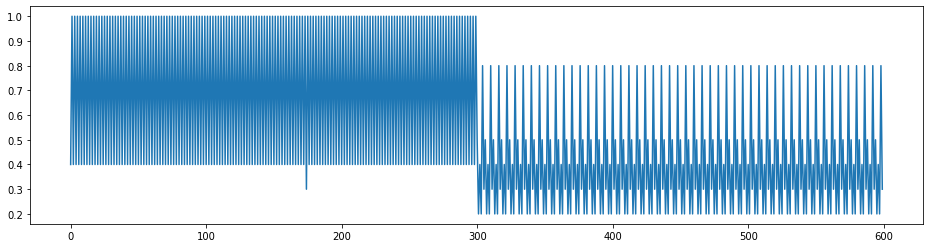

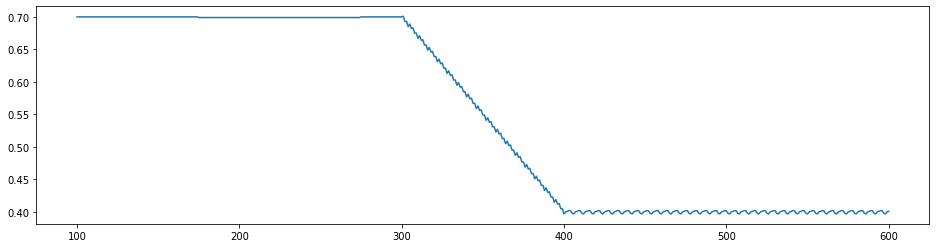

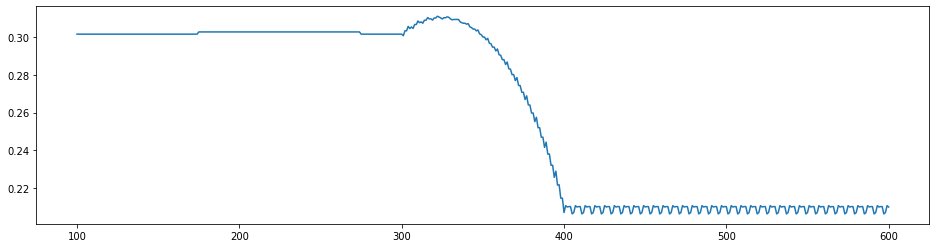

In [17]:
from matplotlib import pyplot as plt

csvFile = "results/driverlog_driverlog_p04_hyp-1_10_3_no-relearn_per50.0.csv"
#data = pd.read_csv("results/driverlog_driverlog_p04_hyp-1_10_3_no-relearn_per50.0.csv")
data = pd.read_csv(csvFile, skiprows=[0], names= ["Real_Goal","Time","Cost","Prob","Results","Relearn"])
p, r, a, bacc = calculate_statistics(data)

# single metric points
plt.figure(1, figsize = (16,4))
plt.plot(bacc)
plt.show()


# moving averages
means, std, timestamps_means = moving_average(bacc, 1, 100)

plt.figure(1, figsize = (16,4))
plt.plot(timestamps_means, means)
plt.show()

# std
plt.figure(1, figsize = (16,4))
plt.plot(timestamps_means, std)
plt.show()

In [41]:
from matplotlib import pyplot as plt

def plotMovingAverage(csv):
    data = pd.read_csv(csv, skiprows=[0], names= ["Real_Goal","Time","Cost","Prob","Results","Relearn"])
    p, r, a, bacc = calculate_statistics(data)
    means, std, timestamps_means = moving_average(bacc, 1, 100)  #average over 100 cases, shift step = 1

    plt.figure(1, figsize = (16,4))
    plt.plot(timestamps_means, means)
    plt.show()
    
    
def plotDataPointsAllGoals(csv):
    
    data = pd.read_csv(csv, skiprows=[0], names= ["Real_Goal","Time","Cost","Prob","Results","Relearn"])
    
    numGoals = data['Real_Goal'].nunique()
    p, r, a, bacc, std_p, std_r, std_a, std_bacc, pointID, relearn = averageMetricAllGoals(data, numGoals)
    
    cdict = {True: 'red', False: 'blue'}
    colors = [cdict[i] for i in relearn]
    
    relearnCount = 0
    for r in relearn:
        if r:
            relearnCount += 1
    
    fig, ax = plt.subplots(1, figsize = (16,4))
    ax.scatter(pointID, bacc, color = colors)
    
    for pos, y, err, colors in zip(pointID, bacc, std_bacc, colors):
   
        ax.errorbar(pos, y, err, color = colors)
    
    
    stats = []
    ##### magic numbers
    if len(bacc) == 100:
        plt.axvspan(50.5, 100.5, facecolor='pink', alpha=0.3)
        stats.append( statistics.mean(bacc[0:50]) )
        stats.append( statistics.mean(bacc[51:100]) )
    if len(bacc) == 150:
        plt.axvspan(50.5, 100.5, facecolor='green', alpha=0.3)
        plt.axvspan(100.5, 150.5, facecolor='pink', alpha=0.3)
        stats.append( statistics.mean(bacc[0:50]) )
        stats.append( statistics.mean(bacc[51:100]) )
        stats.append( statistics.mean(bacc[101:150]) )
    if len(bacc) == 200:
        plt.axvspan(50.5, 100.5, facecolor='pink', alpha=0.3)
        plt.axvspan(150.5, 200.5, facecolor='pink', alpha=0.3)
        stats.append( statistics.mean(bacc[0:50]) )
        stats.append( statistics.mean(bacc[51:100]) )
        stats.append( statistics.mean(bacc[101:150]) )
        stats.append( statistics.mean(bacc[151:200]) )
        
    
    
    problemName = csv.split("/")[-1].split(".")[0]
    plt.title(problemName)
    plt.xlabel("Data Point ID")
    plt.ylabel("Ave ACC over All Goals")
    
    plt.savefig(problemName+".svg")  #or .svg
    plt.show()
    
    return stats, relearnCount
    

def averageBACCBeforeAndAfter(csv):
    data = pd.read_csv(csv, skiprows=[0], names= ["Real_Goal","Time","Cost","Prob","Results","Relearn"])
    
    numGoals = data['Real_Goal'].nunique()
    p, r, a, bacc, std_p, std_r, std_a, std_bacc, pointID, relearn = averageMetricAllGoals(data, numGoals)
    
    ave_bacc_before = statistics.mean(bacc[0:50])
    ave_bacc_after = statistics.mean(bacc[51:100])
    
    return ave_bacc_before, ave_bacc_after
    
    
    



In [148]:
from pathlib import Path
import csv

src = "results/closed_loop_trend"
outFile = "closed_loop_trend"

csvFiles = os.listdir(src)
csvFiles.sort()


f = open(outFile, 'w')
writer = csv.writer(f)
writer.writerow(["problem", "before", "after"])

for file in csvFiles:
    if file != ".DS_Store":
        ave_bacc_before, ave_bacc_after = averageBACCBeforeAndAfter(os.path.join(src, file))
        problemName = file.split("/")[-1].split(".")[0]
        writer.writerow([problemName ,ave_bacc_before, ave_bacc_after])

f.close()
# problemName = csv.split("/")[-1].split(".")[0]
# print(problemName)


### Show images (average and standard dev)

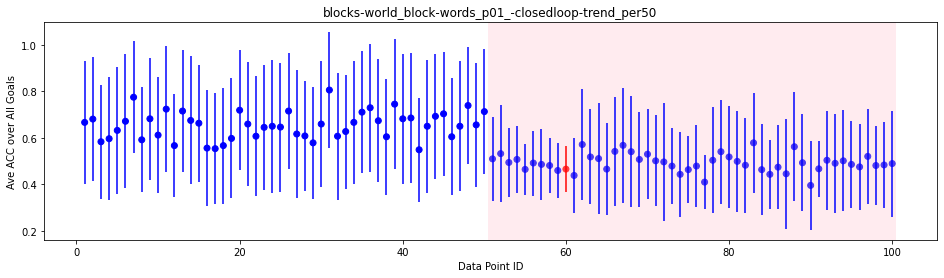

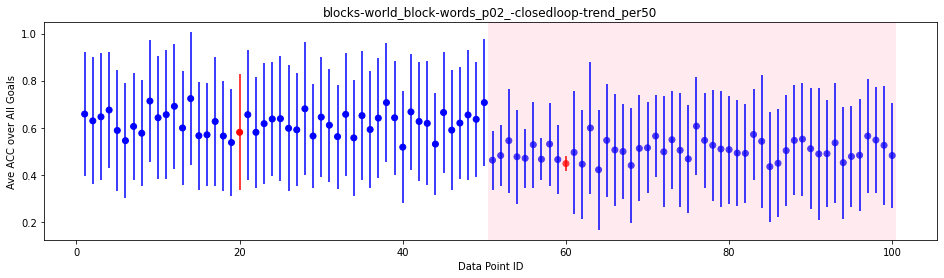

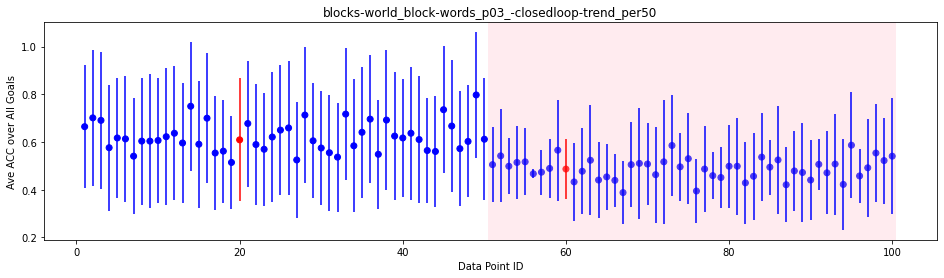

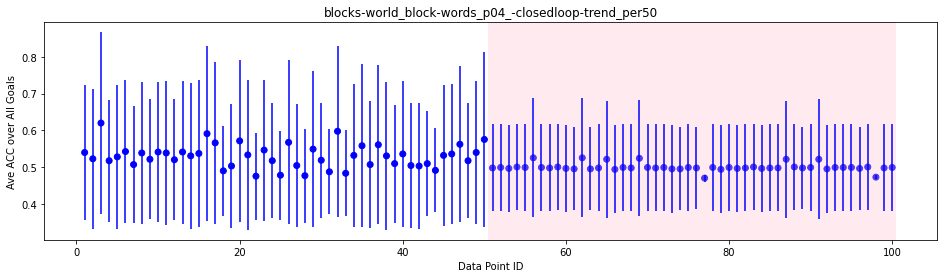

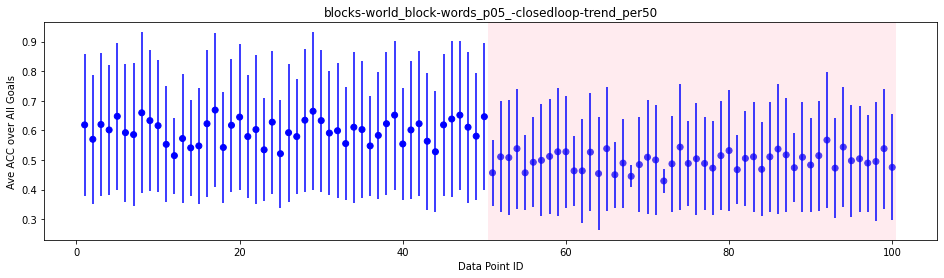

...

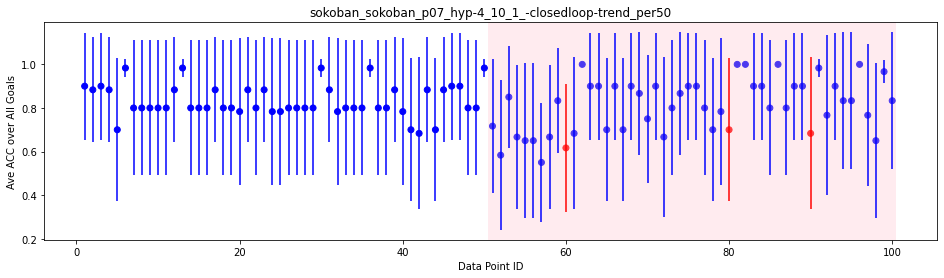

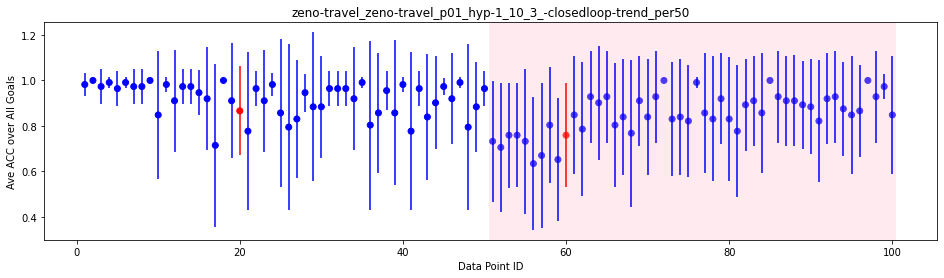

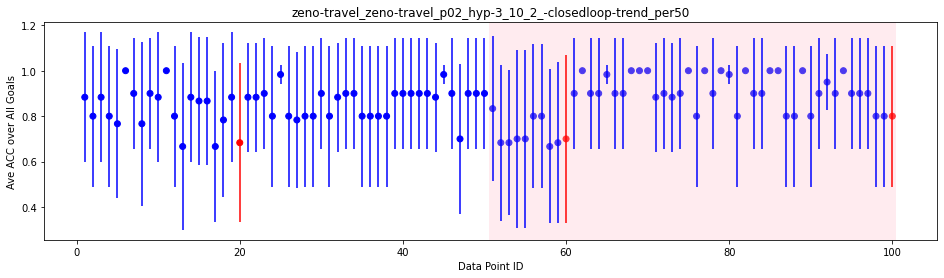

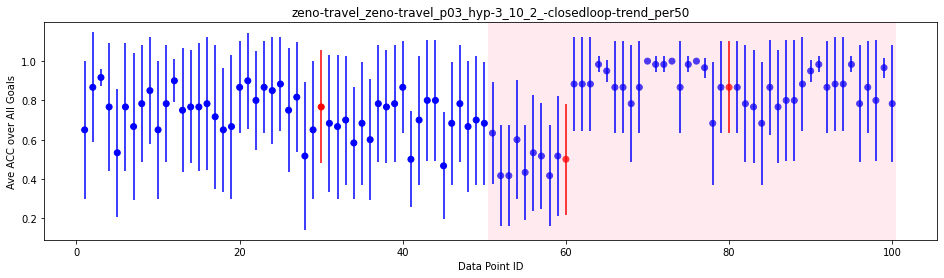

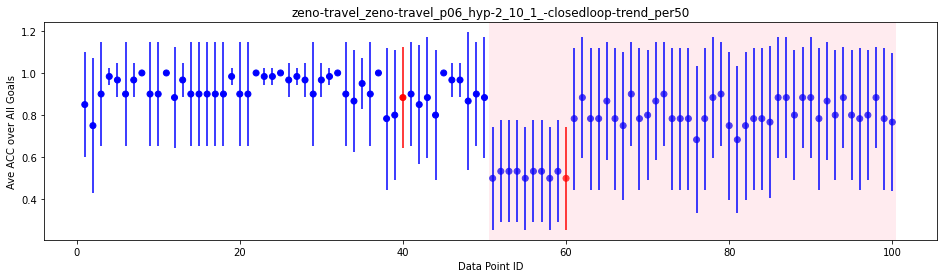

0

In [135]:
from pathlib import Path

src = "results/closed_loop_trend"
out = "images/sudden_closed_loop_trend"

csvFiles = os.listdir(src)
csvFiles.sort()
for file in csvFiles:
    if file != ".DS_Store":
        plotDataPointsAllGoals(os.path.join(src, file))

path = Path(out)
path.mkdir(parents=True, exist_ok=True)

os.system("mv *.svg %s/" % out)
    

satellite_satellite_p03_hyp-3_10_3_-openloop_per50.0.csv


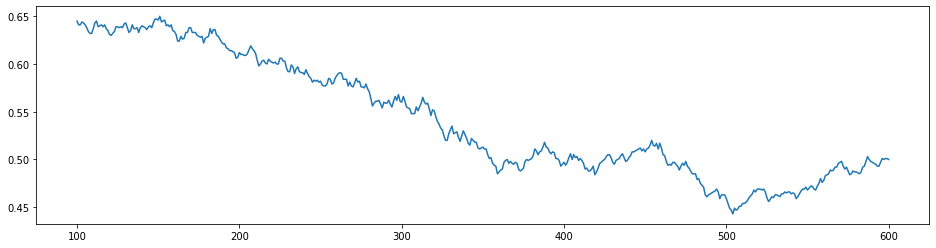

driverlog_driverlog_p03_hyp-1_10_1_-openloop_per50.0.csv


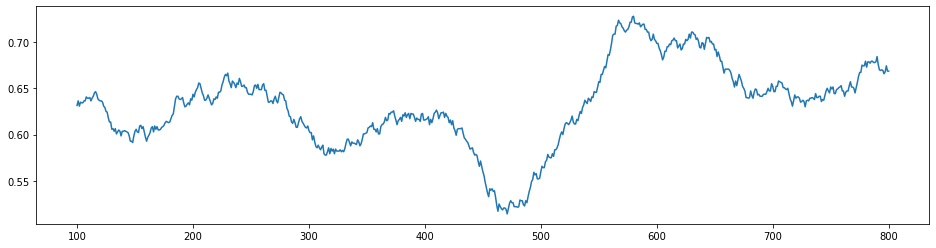

miconic_miconic_p02_hyp-1_10_3_-openloop_per50.0.csv


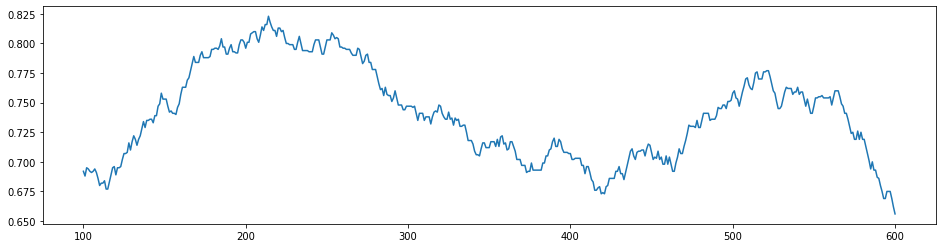

satellite_satellite_p07_hyp-4_10_1_-openloop_per50.0.csv


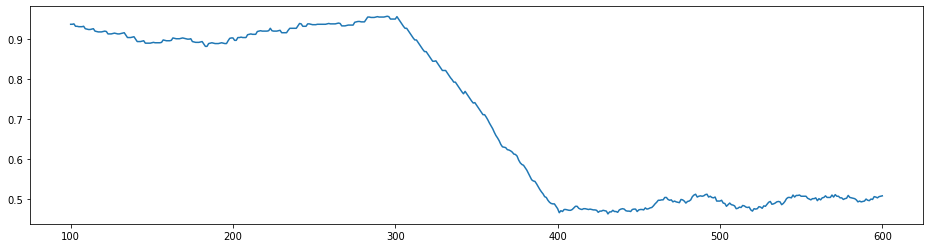

intrusion-detection_intrusion-detection_p10_hyp-4_10_0_-openloop_per50.0.csv


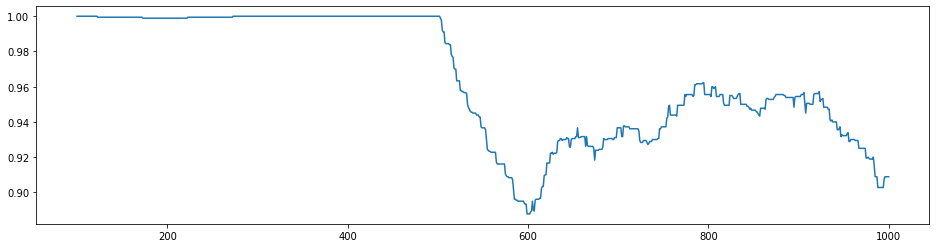

blocks-world_block-words_p02_-openloop_per50.0.csv


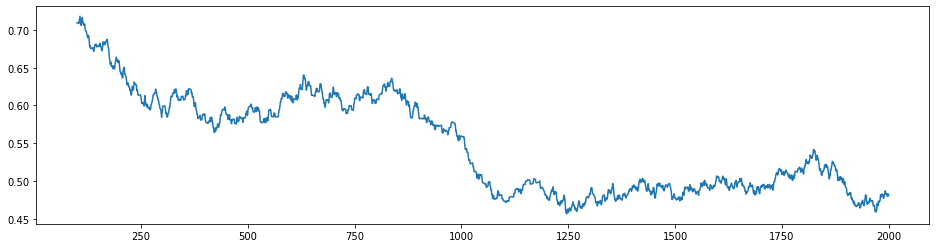

driverlog_driverlog_p02_hyp-2_10_1_-openloop_per50.0.csv


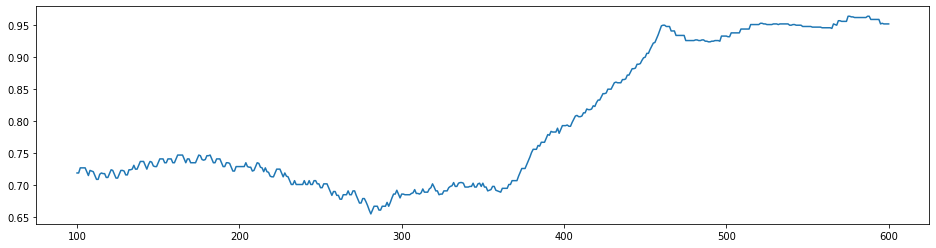

logistics_logistics_p05_hyp-3_10_1_-openloop_per50.0.csv


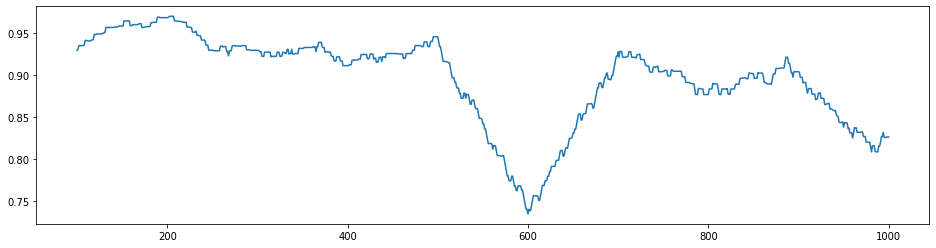

intrusion-detection_intrusion-detection_p20_hyp-2_10_0_-openloop_per50.0.csv


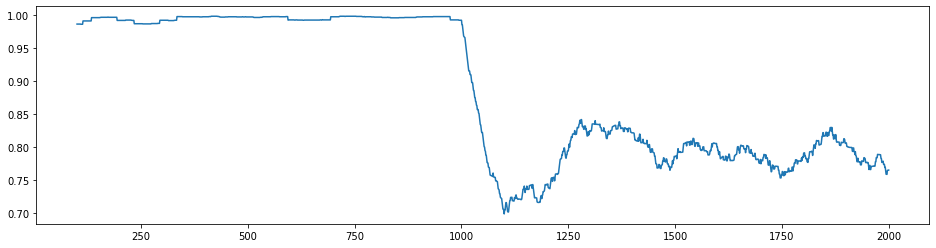

rovers_rovers_p03_hyp-2_10_3_-openloop_per50.0.csv


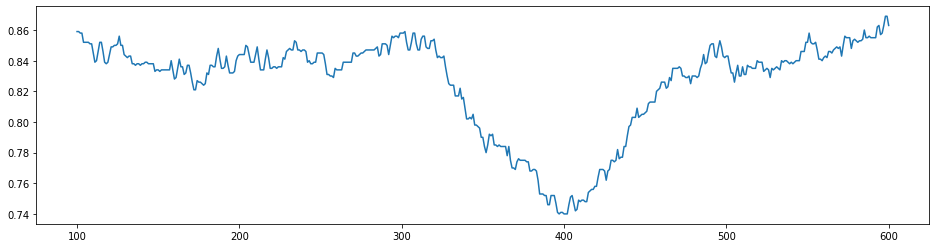

dwr_dwr_p07_hyp-3_10_3_-openloop_per50.0.csv


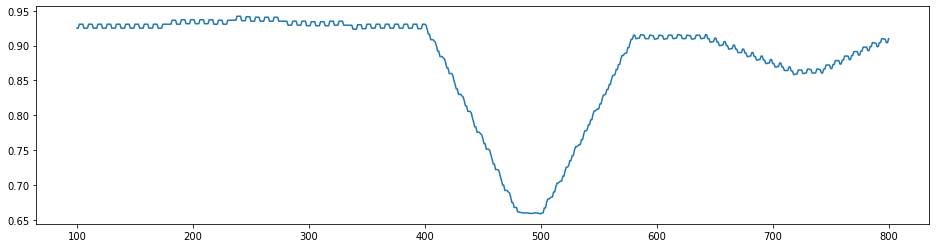

satellite_satellite_p04_hyp-2_10_1_-openloop_per50.0.csv


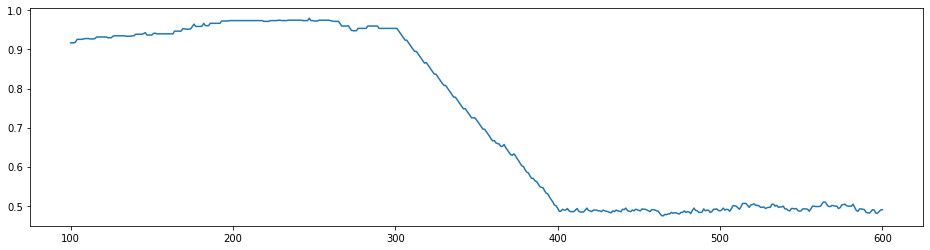

dwr_dwr_p01_hyp-1_10_3_-openloop_per50.0.csv


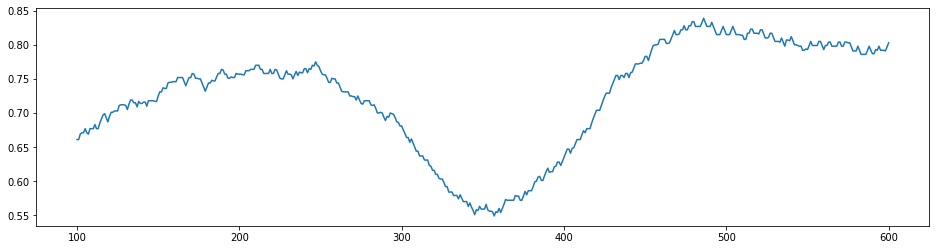

satellite_satellite_p05_hyp-2_10_2_-openloop_per50.0.csv


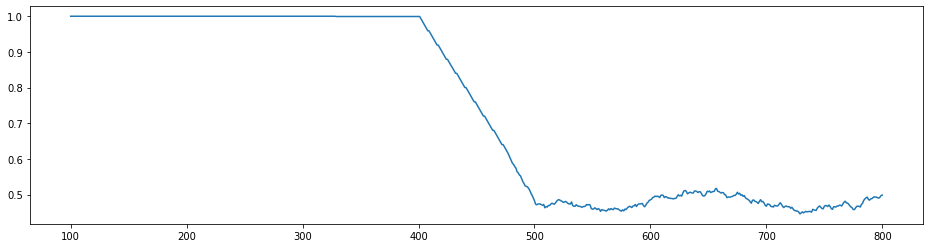

easy-ipc-grid_easy-ipc-grid-aaai_p5-5-5_hyp-2_10_0_-openloop_per50.0.csv


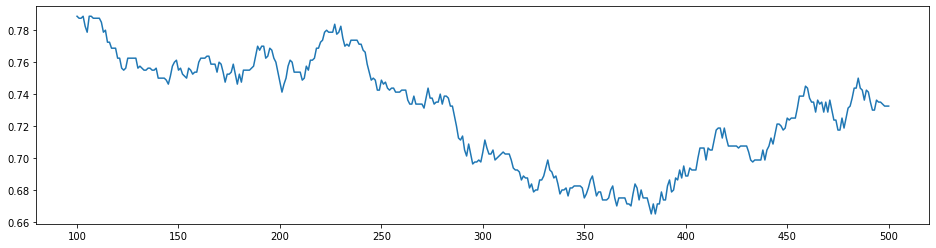

driverlog_driverlog_p05_hyp-4_10_1_-openloop_per50.0.csv


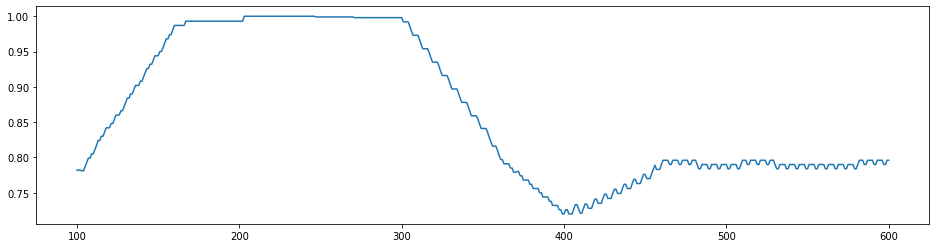

sokoban_sokoban_p06_hyp-2_10_3_-openloop_per50.0.csv


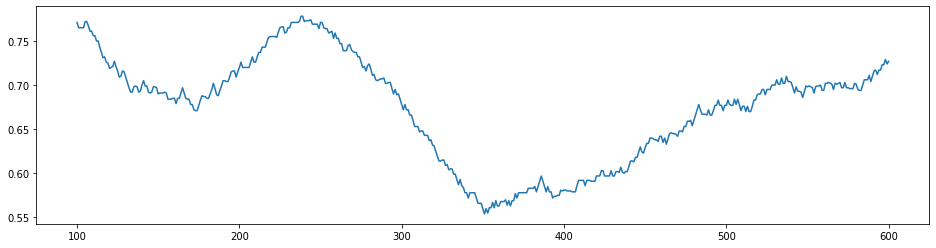

blocks-world_block-words_p06_-openloop_per50.0.csv


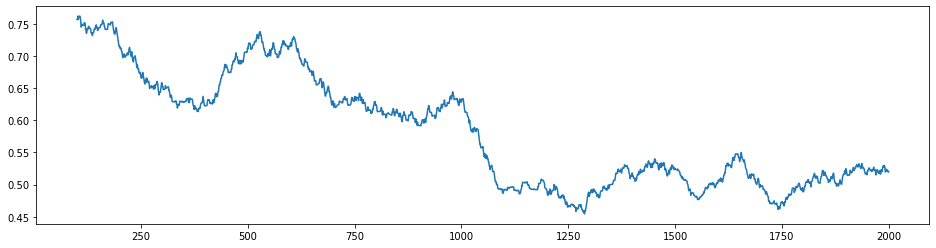

logistics_logistics_p06_hyp-3_10_1_-openloop_per50.0.csv


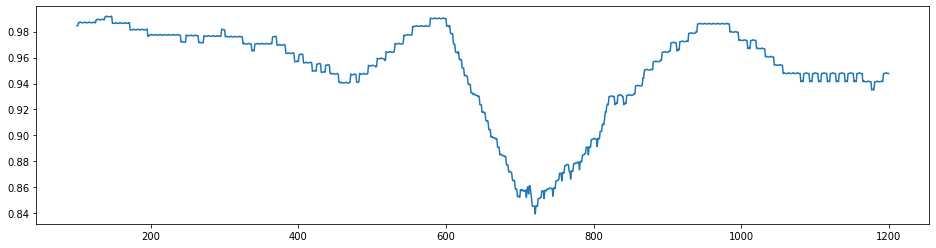

miconic_miconic_p01_hyp-1_10_1_-openloop_per50.0.csv


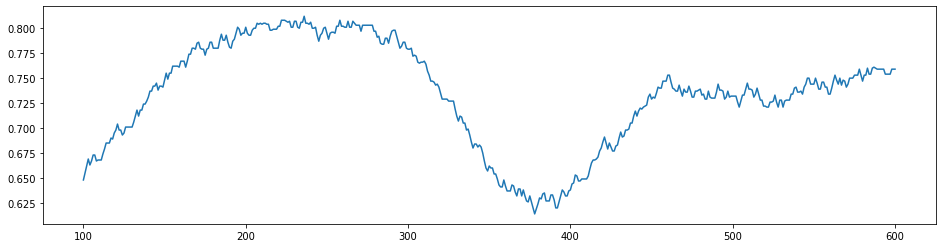

rovers_rovers_p07_hyp-3_10_3_-openloop_per50.0.csv


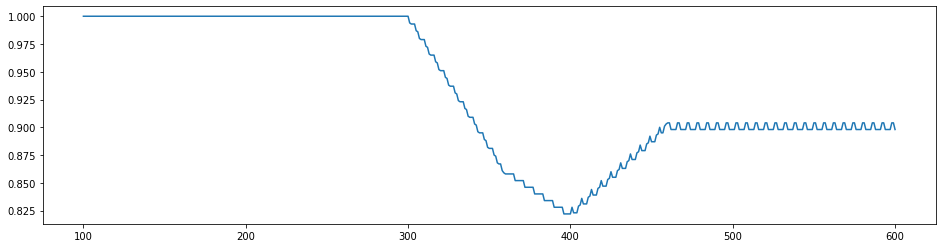

rovers_rovers_p01_hyp-1_10_3_-openloop_per50.0.csv


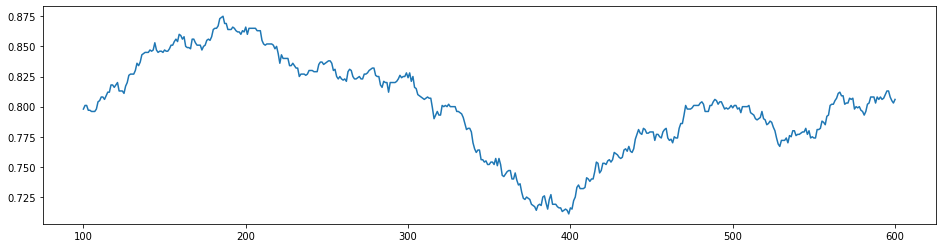

driverlog_driverlog_p04_hyp-1_10_3_-openloop_per50.0.csv


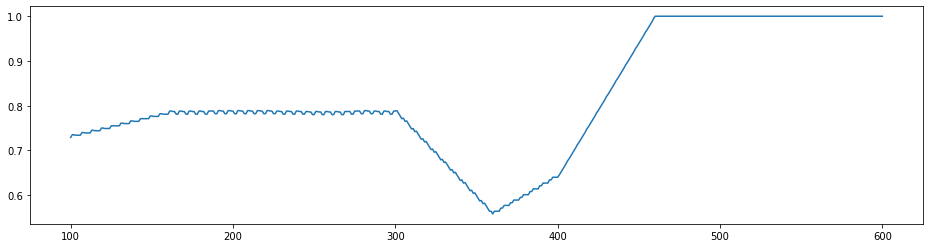

ferry_ferry_p02_hyp-3_10_2_-openloop_per50.0.csv


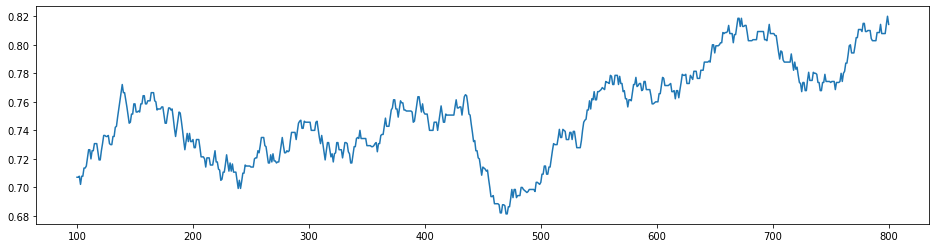

logistics_logistics_p02_hyp-3_10_1_-openloop_per50.0.csv


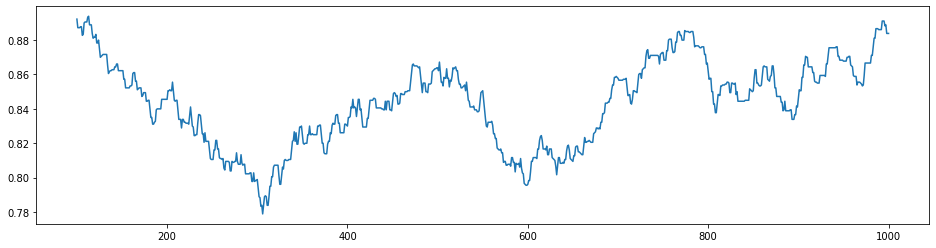

zeno-travel_zeno-travel_p01_hyp-1_10_3_-openloop_per50.0.csv


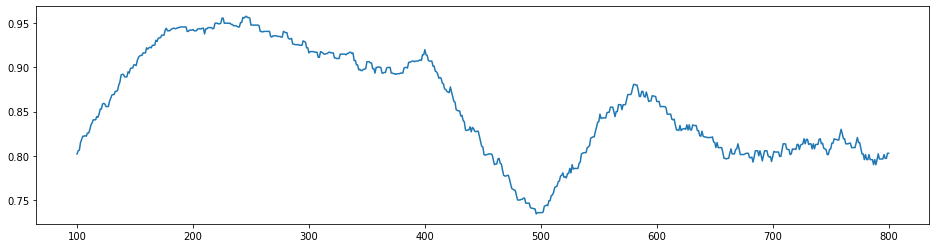

easy-ipc-grid_easy-ipc-grid_p05_hyp-1_10_2_-openloop_per50.0.csv


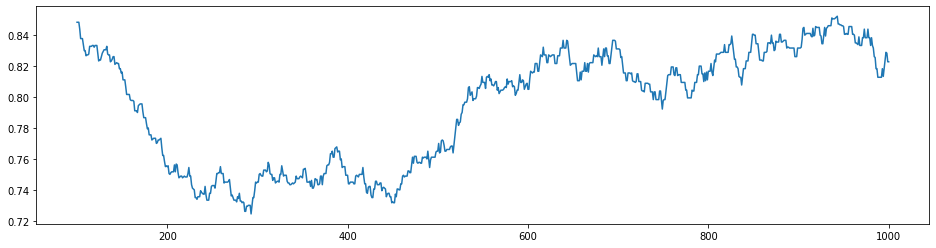

zeno-travel_zeno-travel_p02_hyp-3_10_2_-openloop_per50.0.csv


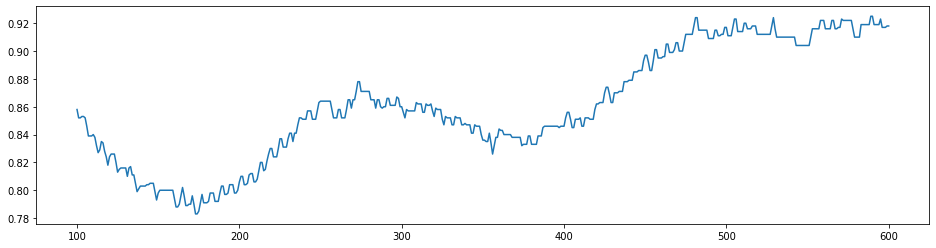

satellite_satellite_p06_hyp-1_10_3_-openloop_per50.0.csv


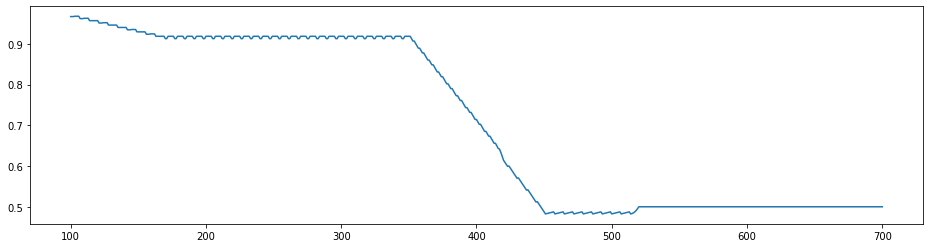

easy-ipc-grid_easy-ipc-grid_p5-10-10_hyp-6_10_1_-openloop_per50.0.csv


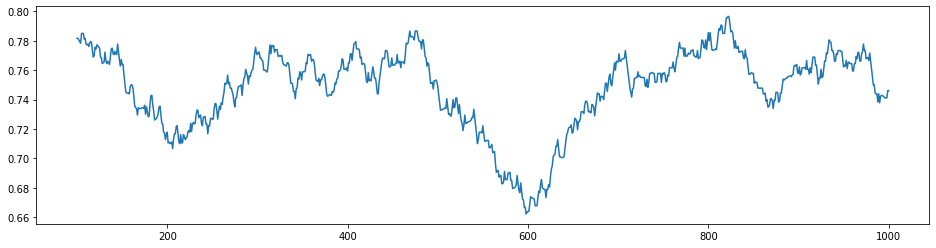

easy-ipc-grid_easy-ipc-grid_p04_hyp-1_10_1_-openloop_per50.0.csv


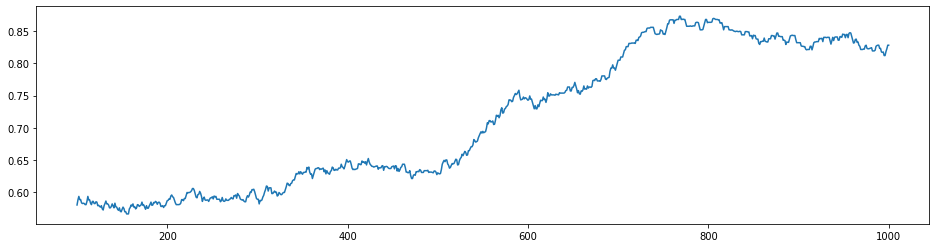

ferry_ferry_p01_hyp-1_10_3_-openloop_per50.0.csv


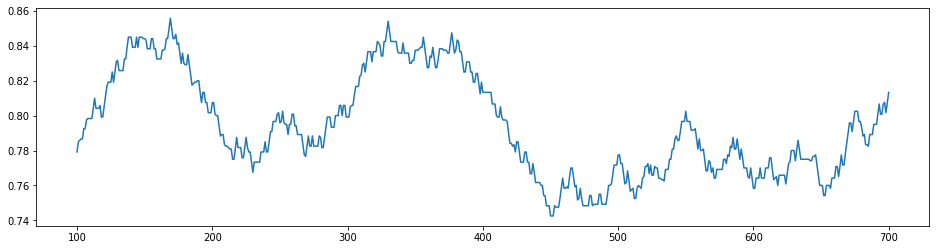

intrusion-detection_intrusion-detection-aaai_p20_hyp-3_10_0_-openloop_per50.0.csv


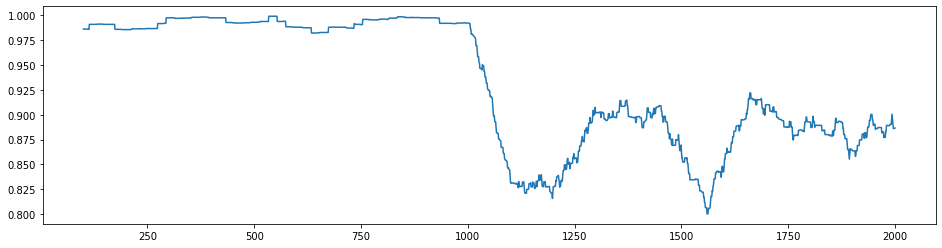

blocks-world_block-words_p04_-openloop_per50.0.csv


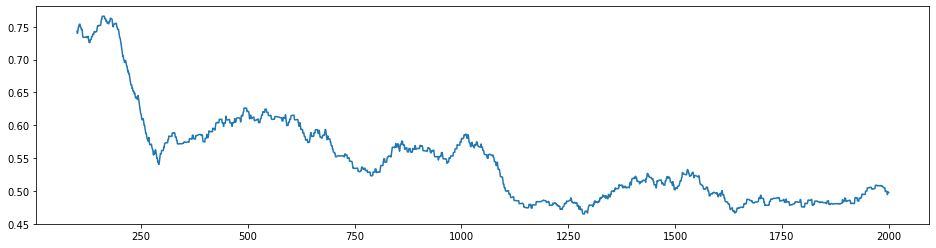

easy-ipc-grid_easy-ipc-grid_p06_hyp-3_10_1_-openloop_per50.0.csv


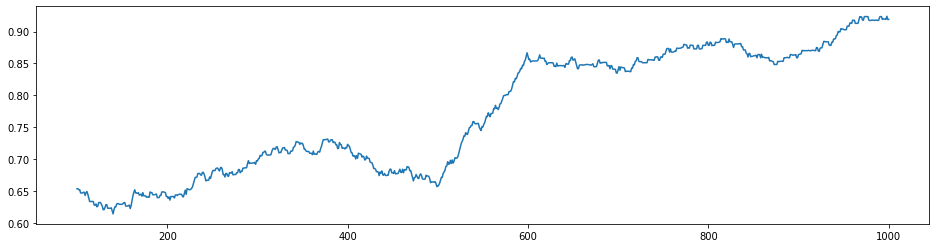

sokoban_sokoban_p01_hyp-3_10_1_-openloop_per50.0.csv


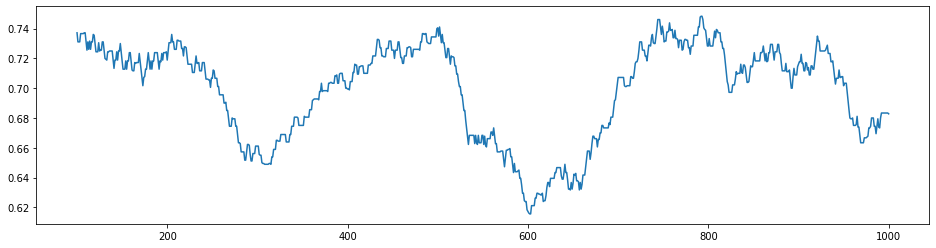

logistics_logistics-aaai_p03_hyp-2_10_0_-openloop_per50.0.csv


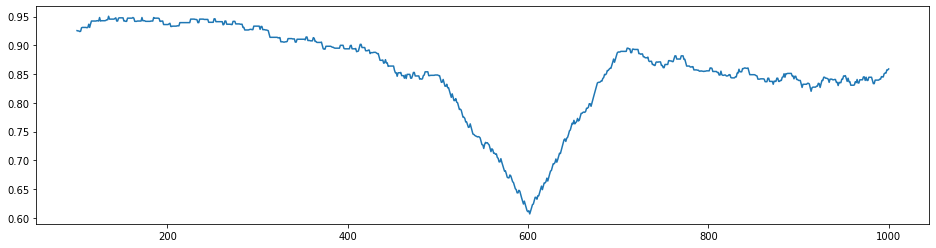

blocks-world_block-words_p03_-openloop_per50.0.csv


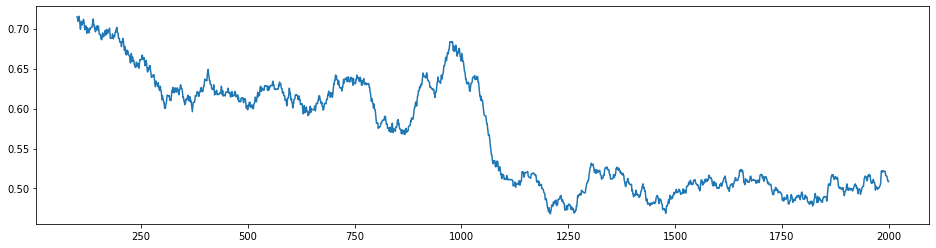

sokoban_sokoban_p07_hyp-4_10_1_-openloop_per50.0.csv


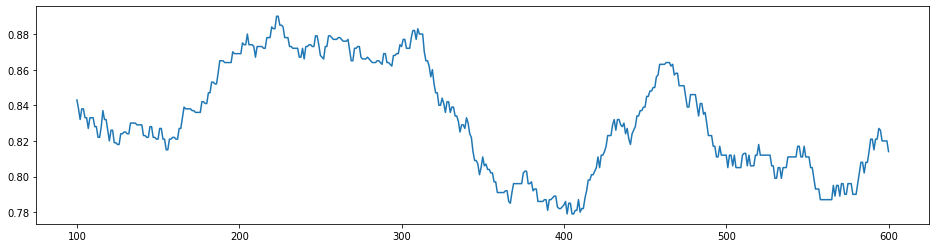

depots_problem03_-openloop_per50.0.csv


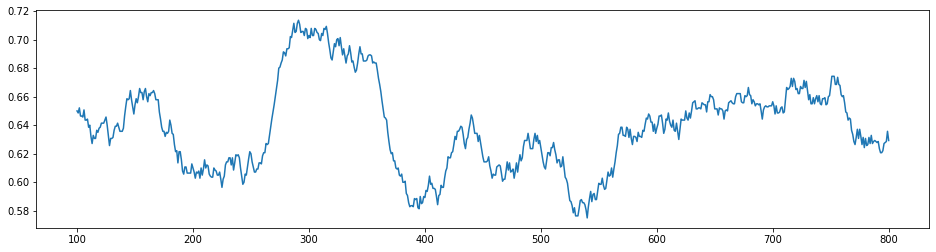

ferry_ferry_p05_hyp-3_10_1_-openloop_per50.0.csv


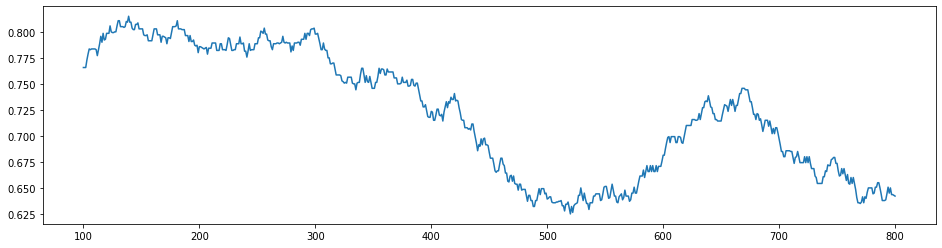

satellite_satellite_p02_hyp-3_10_1_-openloop_per50.0.csv


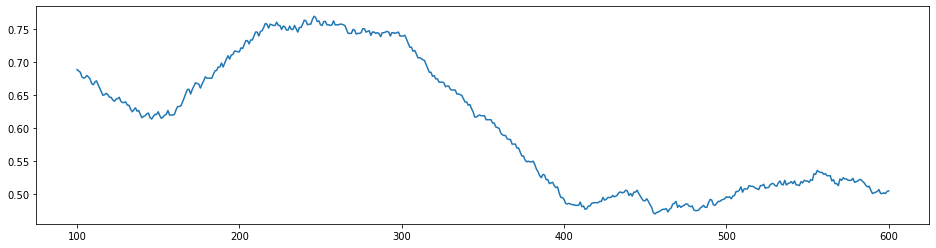

satellite_satellite_p01_hyp-2_10_1_-openloop_per50.0.csv


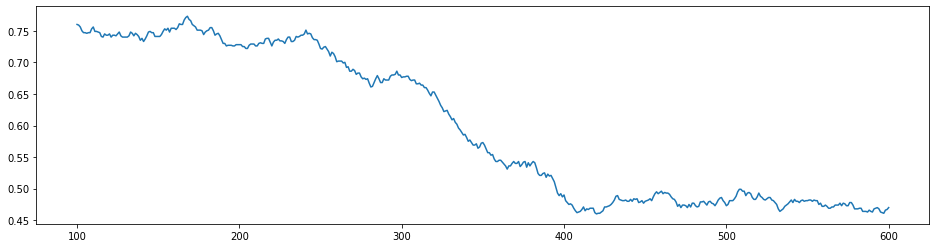

easy-ipc-grid_easy-ipc-grid-aaai_p10-5-5_hyp-2_10_0_-openloop_per50.0.csv


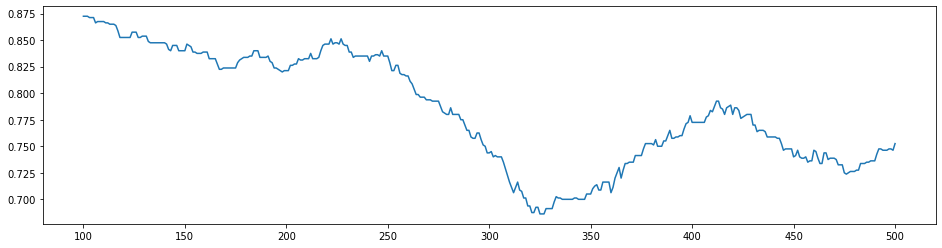

sokoban_sokoban_p03_hyp-4_10_1_-openloop_per50.0.csv


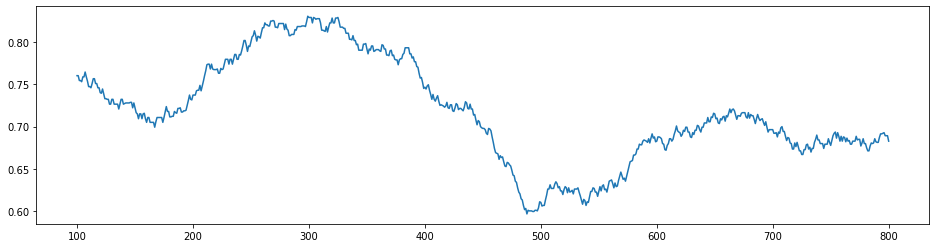

miconic_miconic_p05_hyp-4_10_1_-openloop_per50.0.csv


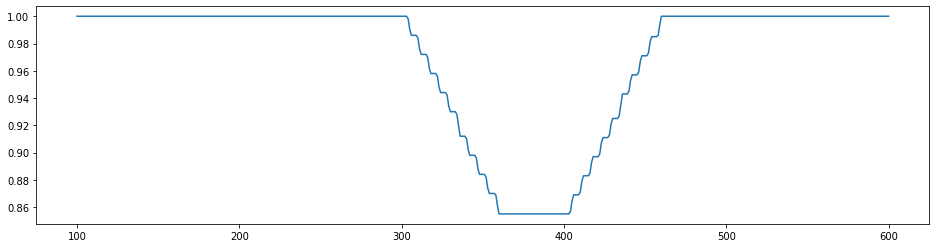

depots_problem01_-openloop_per50.0.csv


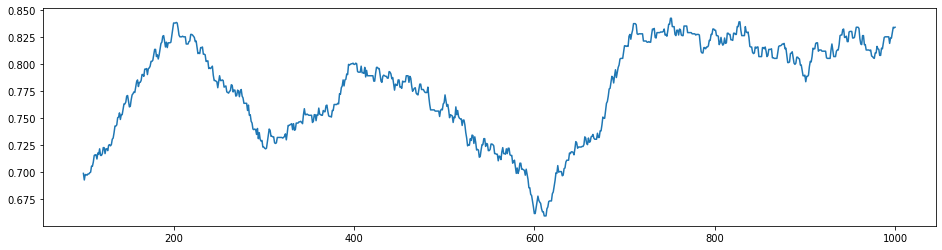

zeno-travel_zeno-travel_p06_hyp-2_10_1_-openloop_per50.0.csv


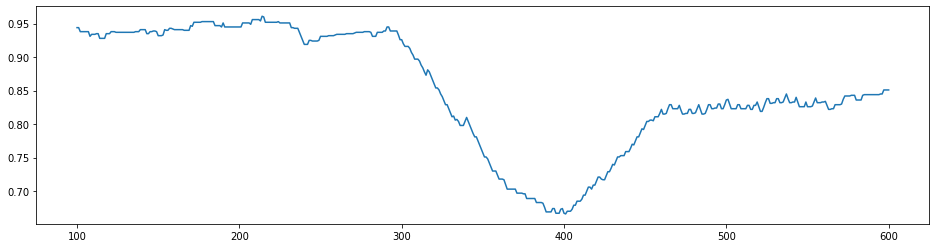

blocks-world_block-words_p01_-openloop_per50.0.csv


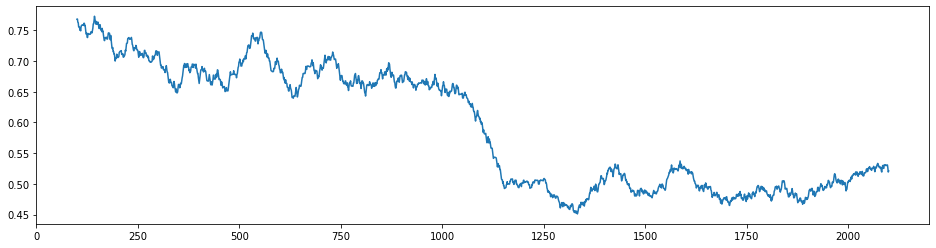

miconic_miconic_p07_hyp-1_10_3_-openloop_per50.0.csv


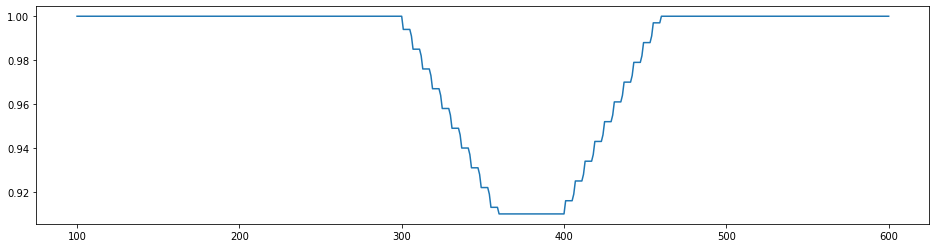

logistics_logistics-aaai_p01_hyp-2_10_0_-openloop_per50.0.csv


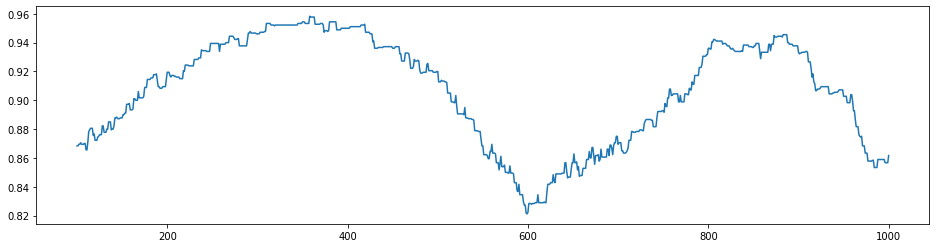

rovers_rovers_p02_hyp-2_10_1_-openloop_per50.0.csv


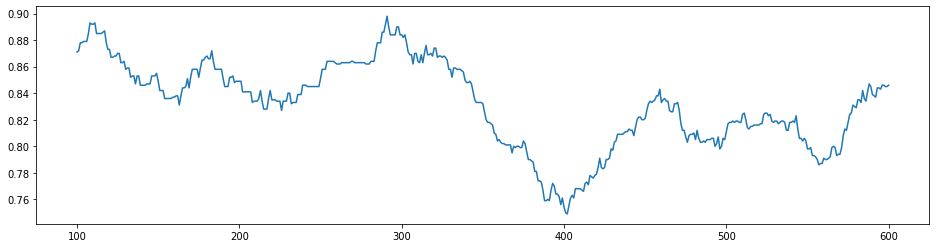

miconic_miconic_p06_hyp-2_10_3_-openloop_per50.0.csv


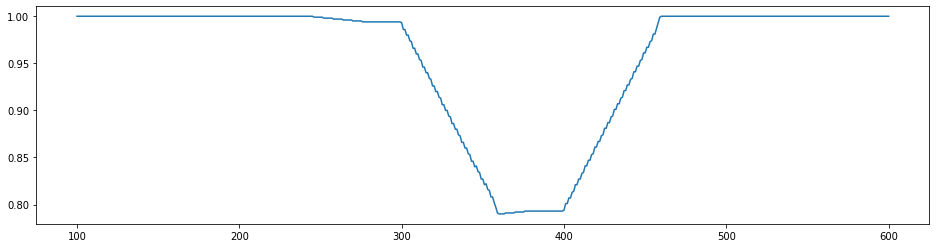

logistics_logistics_p03_hyp-7_10_2_-openloop_per50.0.csv


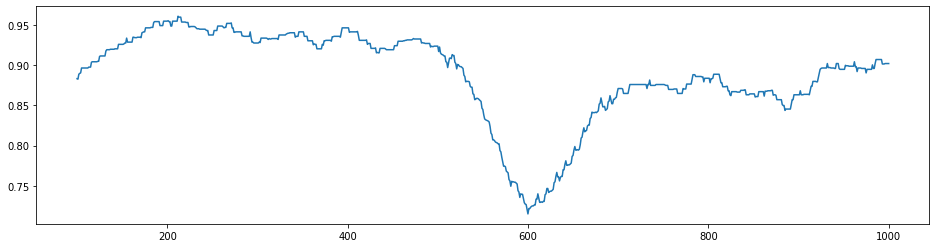

dwr_dwr_p05_hyp-3_10_1_-openloop_per50.0.csv


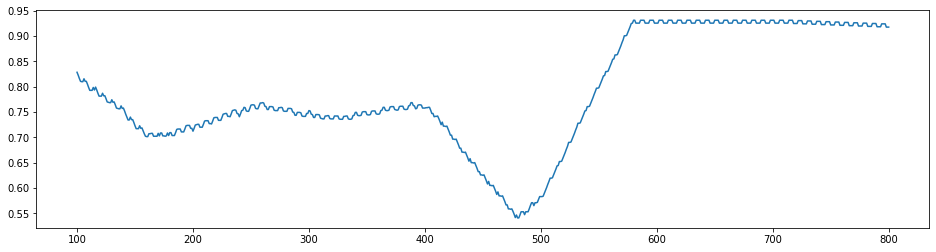

logistics_logistics-aaai_p02_hyp-2_10_0_-openloop_per50.0.csv


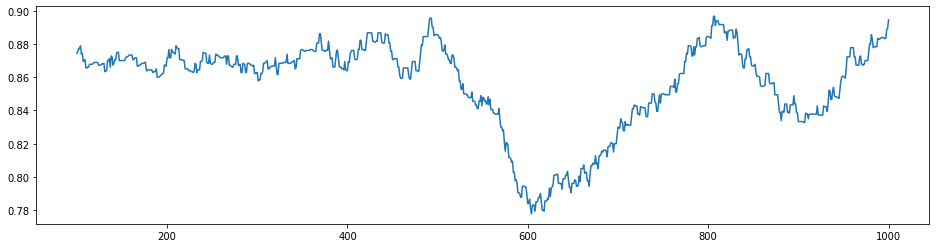

miconic_miconic_p04_hyp-1_10_3_-openloop_per50.0.csv


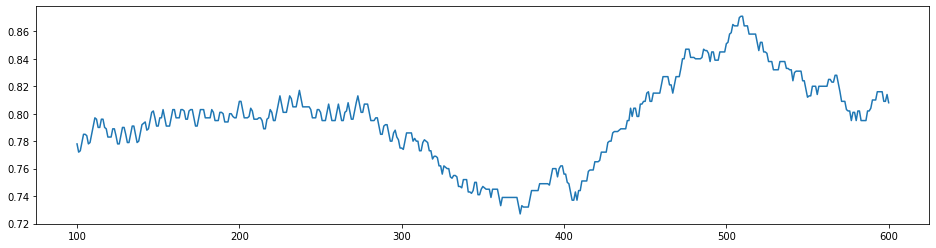

zeno-travel_zeno-travel_p03_hyp-3_10_2_-openloop_per50.0.csv


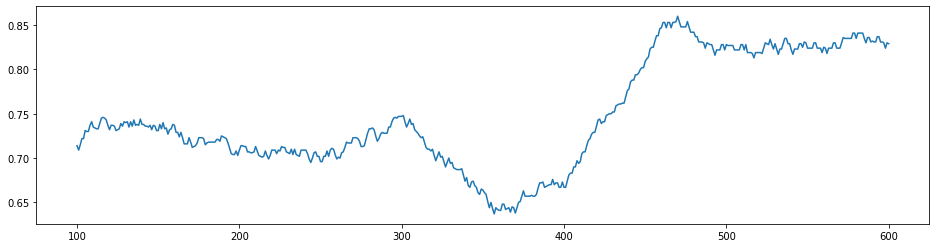

driverlog_driverlog_p01_hyp-1_10_1_-openloop_per50.0.csv


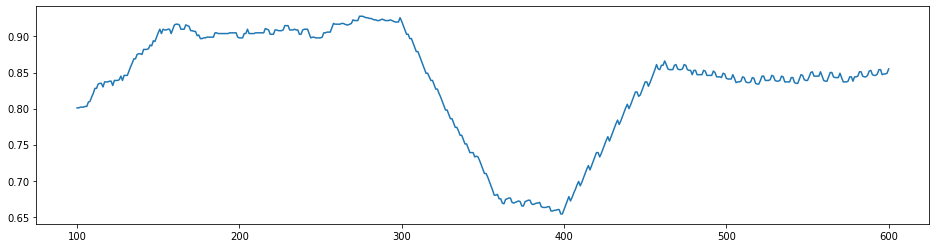

rovers_rovers_p04_hyp-2_10_2_-openloop_per50.0.csv


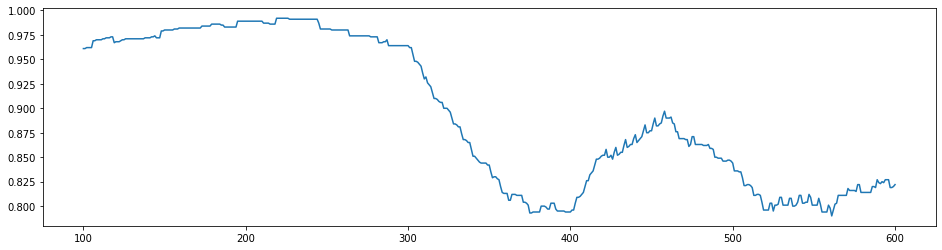

dwr_dwr_p03_hyp-2_10_2_-openloop_per50.0.csv


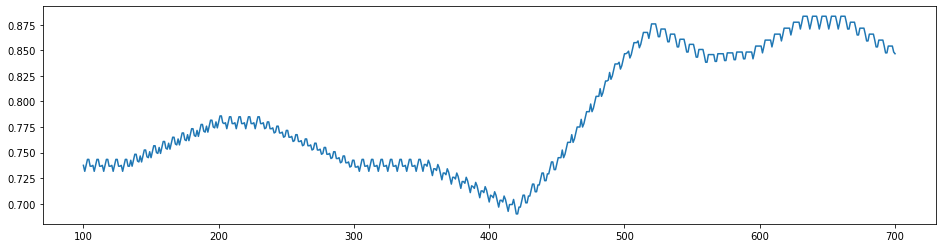

easy-ipc-grid_easy-ipc-grid_p10-5-5_hyp-1_10_1_-openloop_per50.0.csv


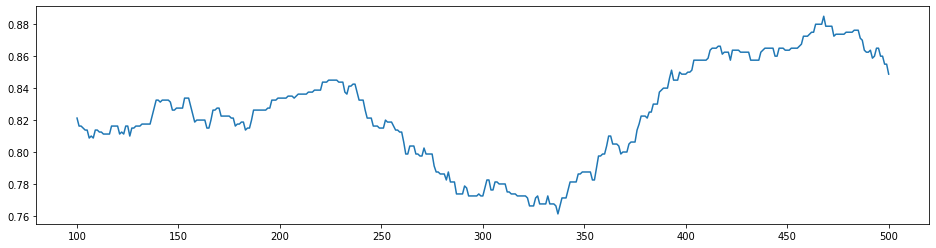

sokoban_sokoban_p04_hyp-3_10_1_-openloop_per50.0.csv


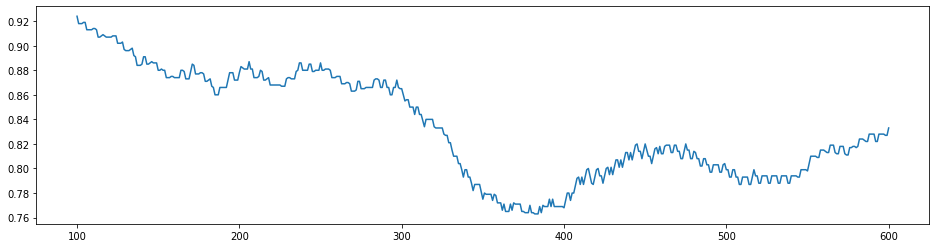

ferry_ferry_p03_hyp-4_10_2_-openloop_per50.0.csv


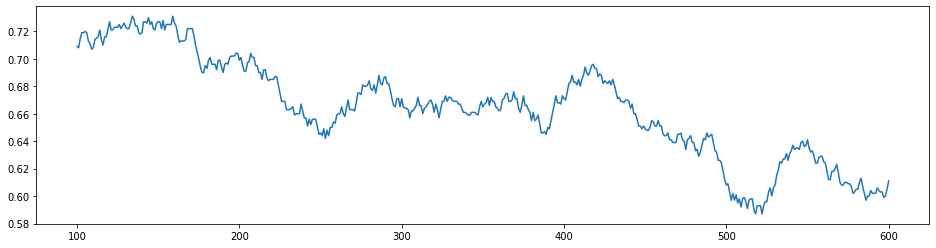

logistics_logistics_p07_hyp-3_10_3_-openloop_per50.0.csv


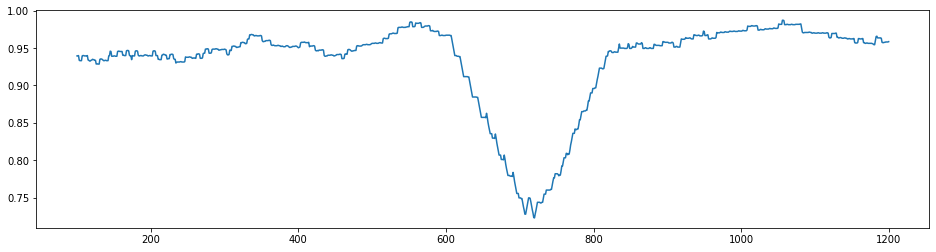

easy-ipc-grid_easy-ipc-grid-aaai_p5-10-10_hyp-2_10_0_-openloop_per50.0.csv


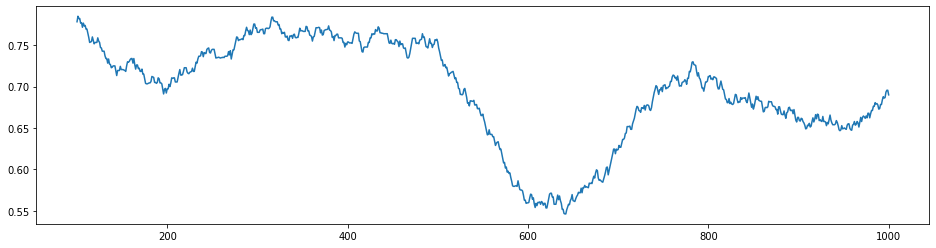

easy-ipc-grid_easy-ipc-grid_p5-5-5_hyp-1_10_1_-openloop_per50.0.csv


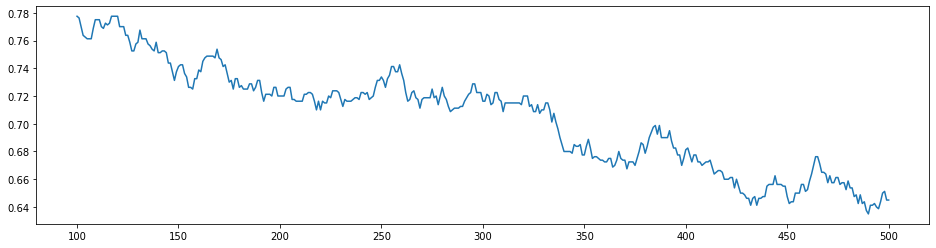

logistics_logistics_p01_hyp-2_10_2_-openloop_per50.0.csv


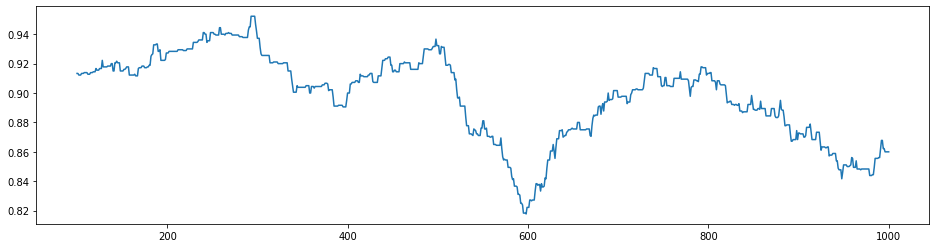

sokoban_sokoban_p05_hyp-4_10_2_-openloop_per50.0.csv


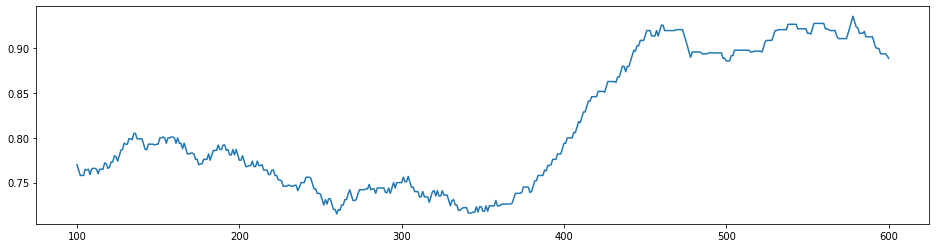

miconic_miconic_p03_hyp-3_10_2_-openloop_per50.0.csv


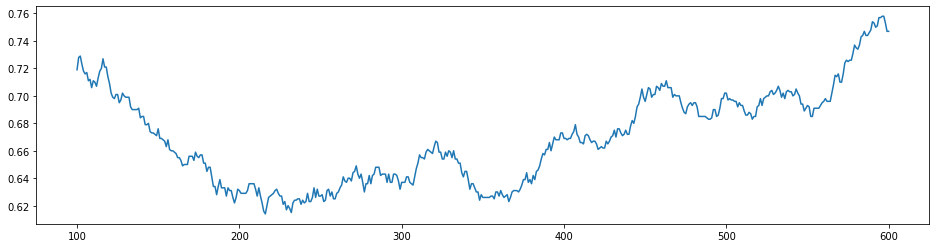

rovers_rovers_p06_hyp-4_10_1_-openloop_per50.0.csv


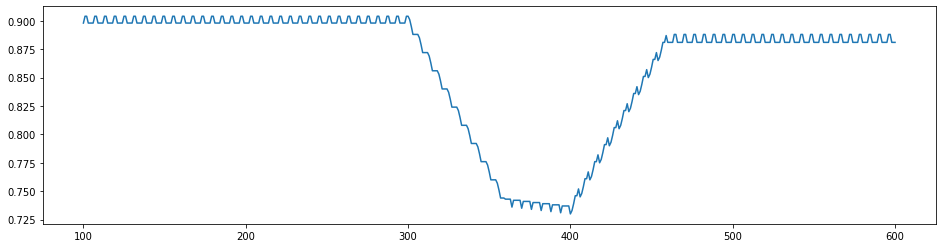

easy-ipc-grid_easy-ipc-grid_p07_hyp-3_10_3_-openloop_per50.0.csv


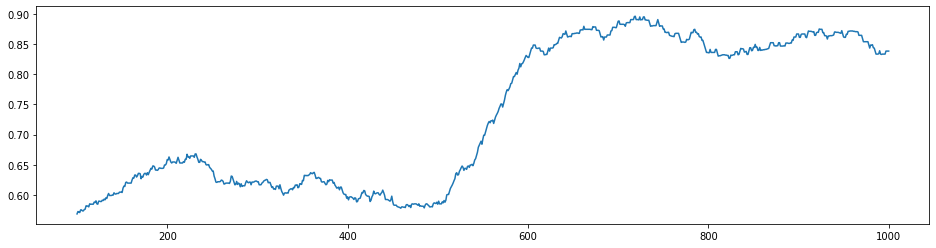

ferry_ferry_p06_hyp-3_10_1_-openloop_per50.0.csv


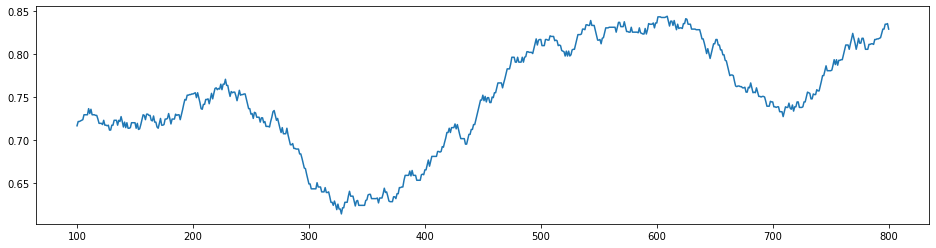

blocks-world_block-words_p05_-openloop_per50.0.csv


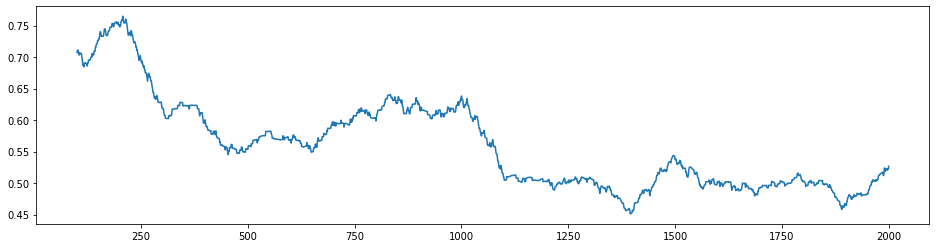

ferry_ferry_p04_hyp-2_10_2_-openloop_per50.0.csv


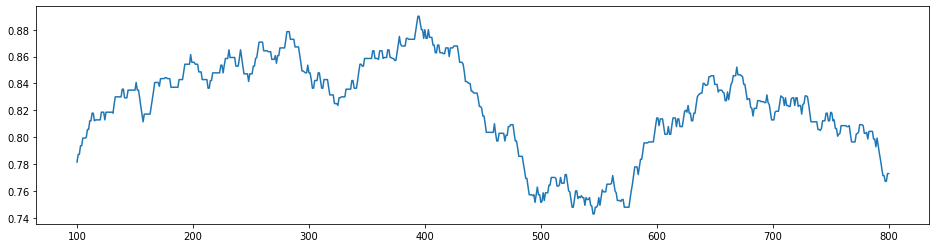

dwr_dwr_p02_hyp-2_10_3_-openloop_per50.0.csv


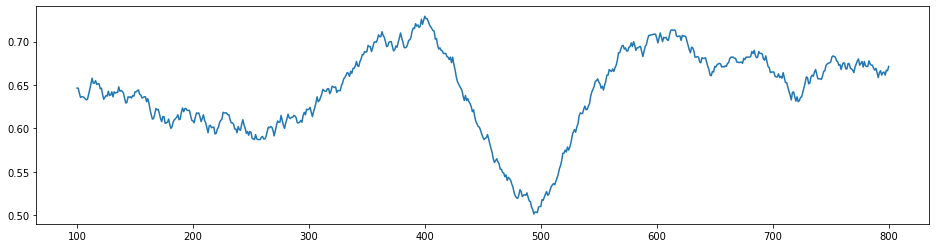

In [96]:
def plotMovingAverageRL(csv):
    data = pd.read_csv(csv, skiprows=[0], names= ["Real_Goal","Time","Cost","Prob","Results","Relearn"])
    
    p, r, a, bacc = calculate_statistics(data)
    means, timestamps_means = window_shifting_means(bacc, 1, 100)  #average over 100 cases, shift step = 1

    plt.figure(1, figsize = (16,4))
    plt.plot(timestamps_means, means)
    plt.show()
    
open_loop = "results-open-loop"
for file in os.listdir(open_loop):
    if file != ".DS_Store":
        print(file)
        plotMovingAverageRL(open_loop+"/"+file)

In [3]:
from pathlib import Path
import csv

def listDirWithoutHidden(aDir):
    lst = os.listdir(aDir)
    for item in lst:
        if item[0] == ".":
            lst.remove(item)
            
    return lst


def averageBACCPerPeriod(csv):
    data = pd.read_csv(csv, skiprows=[0], names= ["Real_Goal","Time","Cost","Prob","Results","Relearn"])
    
    numGoals = data['Real_Goal'].nunique()
    p, r, a, bacc, std_p, std_r, std_a, std_bacc, pointID, relearn = averageMetricAllGoals(data, numGoals)
    
    ave_bacc_before = statistics.mean(bacc[0:50])
    ave_bacc_after = statistics.mean(bacc[51:100])
    
    return ave_bacc_before, ave_bacc_after

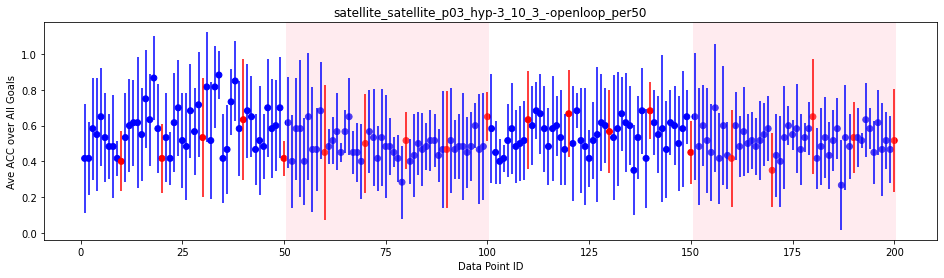

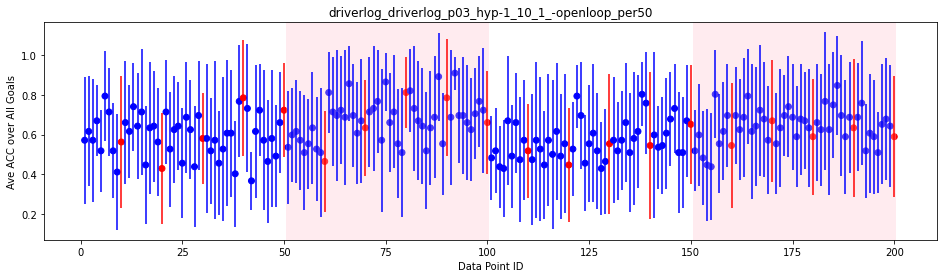

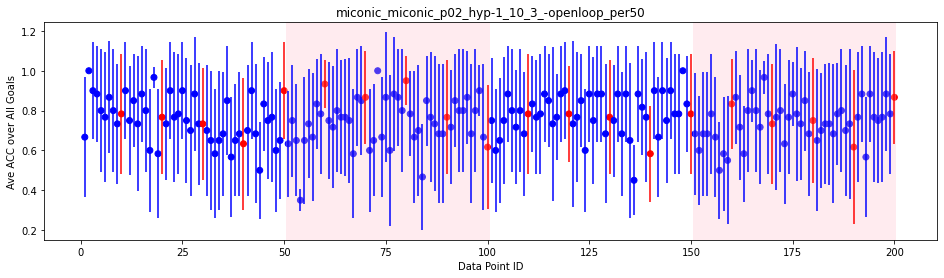

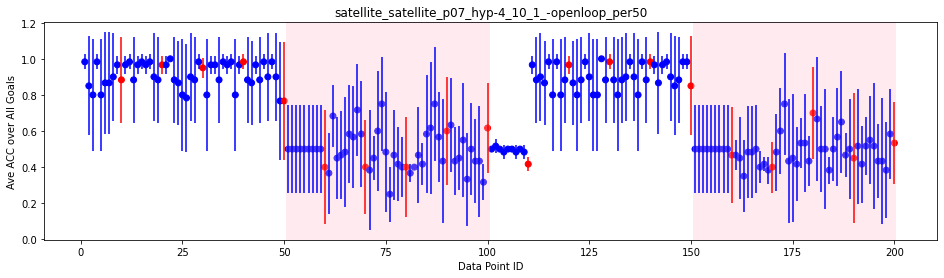

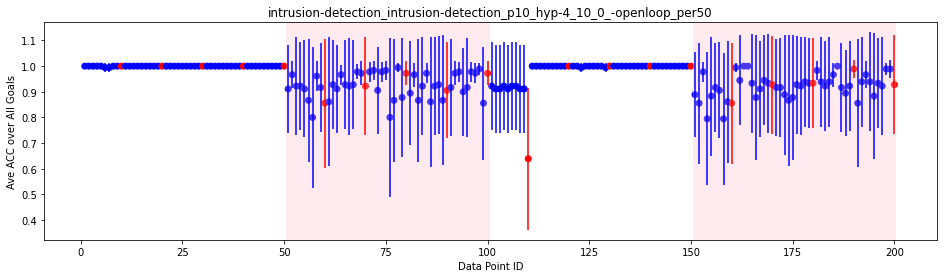

...

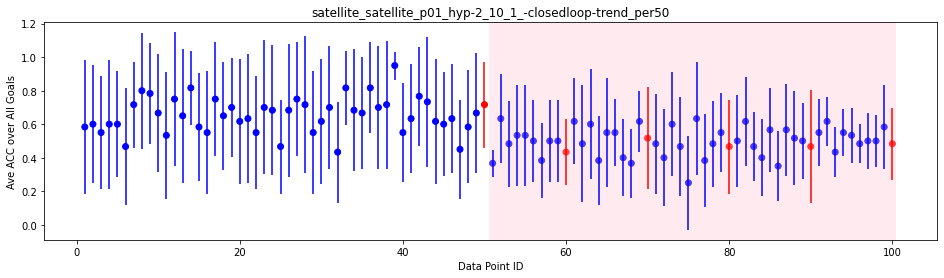

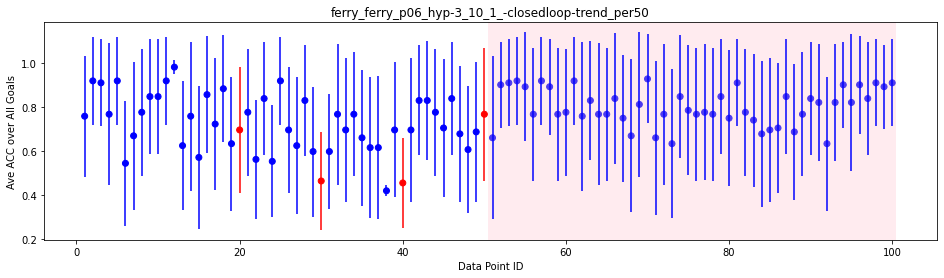

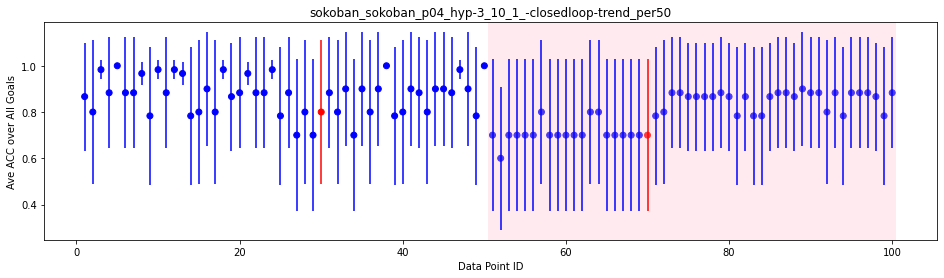

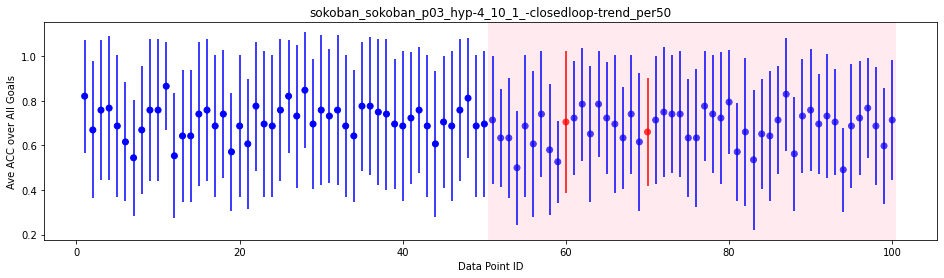

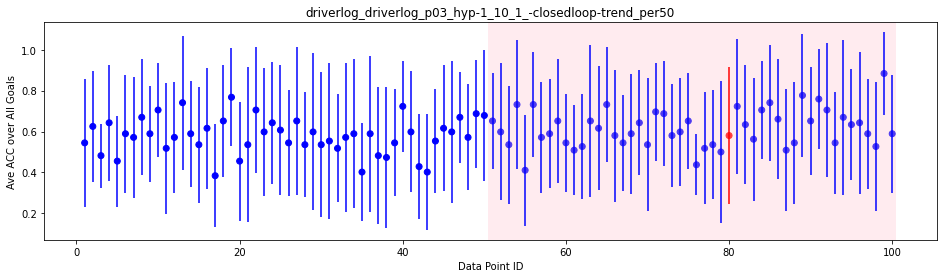

In [43]:
src = "results"
outCSV = "stat_data.csv"

os.system("rm -rf images")
os.system("rm -rf %s" % outCSV)

f = open(outCSV, 'w')
writer = csv.writer(f)
writer.writerow(["drift", "system", "problem", "relearn counts", "0-50", "51-100", "101-150", "151-200"])

for drift in listDirWithoutHidden(src):
    pathToDrift = os.path.join(src,drift)
    
    for sys in listDirWithoutHidden(pathToDrift):
        pathToSys = os.path.join(pathToDrift,sys)
        #make output dir
        output = Path(pathToSys.replace(src, "images"))
        output.mkdir(parents=True, exist_ok=True)
        
        for file in listDirWithoutHidden(pathToSys):
            pathToFile = os.path.join(pathToSys,file)
            stats, relearnCount = plotDataPointsAllGoals(pathToFile)
            
            out = [drift ,sys, file, relearnCount] + stats
            writer.writerow(out)
            os.system("mv *.svg %s/" % output)

f.close()


In [4]:
src = "images"


drift = ["reoccurring", "gradual", "sudden"]
sys = ["no_relearn", "open_loop", "closed_loop_ave", "closed_loop_trend"]

for drift in listDirWithoutHidden(src):
    pathToDrift = os.path.join(src,drift)
    
    sys1 = os.path.join(pathToDrift,sys[0])
    sys2 = os.path.join(pathToDrift,sys[1])
    sys3 = os.path.join(pathToDrift,sys[2])
    sys4 = os.path.join(pathToDrift,sys[3])
    
    sortedFileLst1 = listDirWithoutHidden(sys1)
    sortedFileLst1.sort()
    sortedFileLst2 = listDirWithoutHidden(sys2)
    sortedFileLst2.sort()
    sortedFileLst3 = listDirWithoutHidden(sys3)
    sortedFileLst3.sort()
    sortedFileLst4 = listDirWithoutHidden(sys4)
    sortedFileLst4.sort()
    
    for i in range(len(sortedFileLst1)):
        domain = sortedFileLst1[i].split("_")[0]
        print("#### Problem " + str(i) + " ("+domain+")")
        
        pathToFile = os.path.join(sys1,sortedFileLst1[i])
        print("![image](%s)" % pathToFile)
        pathToFile = os.path.join(sys2,sortedFileLst2[i])
        print("![image](%s)" % pathToFile)
        pathToFile = os.path.join(sys3,sortedFileLst3[i])
        print("![image](%s)" % pathToFile)
        pathToFile = os.path.join(sys4,sortedFileLst4[i])
        print("![image](%s)" % pathToFile)


FileNotFoundError: [Errno 2] No such file or directory: 'images'

In [150]:
## R&G
csvFile = "/Users/zihangs/eclipse-workspace/GR_system/comparison/final_compare/RG_BFWS/blocks-world.csv"
data = pd.read_csv(csvFile)

In [151]:
data

,Percent,Real_Goal,Time,Results,Candidates,Path
0,10,19,32.524535,17/19/,20,gene_data/blocks-world/problems/10/149/*.tar.bz2
1,10,15,188.041336,1/2/3/4/5/7/8/9/11/12/15/16/17/19/20/21/,21,gene_data/blocks-world/problems/10/32/*.tar.bz2
2,10,5,1.594820,4/,20,gene_data/blocks-world/problems/10/120/*.tar.bz2
3,10,9,82.212705,8/9/11/20/,20,gene_data/blocks-world/problems/10/178/*.tar.bz2
4,10,19,32.384636,17/19/,20,gene_data/blocks-world/problems/10/161/*.tar.bz2
...,...,...,...,...,...,...
915,100,17,3.113298,12/,20,gene_data/blocks-world/problems/100/6/*.tar.bz2
916,100,17,7.436381,17/,21,gene_data/blocks-world/problems/100/22/*.tar.bz2
917,100,15,8.099353,15/,21,gene_data/blocks-world/problems/100/20/*.tar.bz2
918,100,14,2.671446,2/,20,gene_data/blocks-world/problems/100/40/*.tar.bz2


In [3]:
csvFile = "/Users/zihangs/My_PHD/projects/continuous_GR/stat_data.csv"
data = pd.read_csv(csvFile)

In [55]:
data

,drift,system,problem,relearn counts,0-50,51-100,101-150,151-200
0,gradual,closed_loop_ave,blocks-world_block-words_p01_-closedloop_ave_m...,6,0.658643,0.580515,0.504106,NaN
1,gradual,closed_loop_trend,blocks-world_block-words_p01_-closedloop-trend...,5,0.658643,0.575705,0.501725,NaN
2,gradual,no_relearn,blocks-world_block-words_p01_-no-relearn_per50...,0,0.658643,0.580515,0.506171,NaN
3,gradual,open_loop,blocks-world_block-words_p01_-openloop_per50.0...,15,0.677952,0.575972,0.503158,NaN
4,gradual,closed_loop_ave,blocks-world_block-words_p02_-closedloop_ave_m...,3,0.614526,0.552041,0.505236,NaN
...,...,...,...,...,...,...,...,...
907,sudden,open_loop,zeno-travel_zeno-travel_p03_hyp-3_10_2_-openlo...,10,0.716000,0.803401,NaN,NaN
908,sudden,closed_loop_ave,zeno-travel_zeno-travel_p06_hyp-2_10_1_-closed...,1,0.927333,0.760884,NaN,NaN
909,sudden,closed_loop_trend,zeno-travel_zeno-travel_p06_hyp-2_10_1_-closed...,4,0.921667,0.792177,NaN,NaN
910,sudden,no_relearn,zeno-travel_zeno-travel_p06_hyp-2_10_1_-no-rel...,0,0.927333,0.536054,NaN,NaN


In [5]:
# def groupSystems(data):
#     for 

def diffList(list1, list2):
    lst = []
    for i in range(len(list1)):
        lst.append( list2[i]-list1[i] ) 
    
    return lst

length = data.shape[0]
groups = []
aGroup = []

count_valid_problems = 0
count_good_solutions = 0

print("|  drift |  domain  |     diff      |   0 - 50   |   51 - 100   |   101 - 150   |   151 - 200   |")
print("|:-------|:---------|:--------------|:-----------|:-------------|:--------------|:--------------|")

for index, row in data.iterrows():
    if index%4 == 0:
        aGroup = []
        
    aGroup.append(row)
    if len(aGroup) == 4:
        
        matrix = [[aGroup[2]["0-50"], aGroup[2]["51-100"], aGroup[2]["101-150"], aGroup[2]["151-200"]],
                  [aGroup[3]["0-50"], aGroup[3]["51-100"], aGroup[3]["101-150"], aGroup[3]["151-200"]],
                  [aGroup[0]["0-50"], aGroup[0]["51-100"], aGroup[0]["101-150"], aGroup[0]["151-200"]],
                  [aGroup[1]["0-50"], aGroup[1]["51-100"], aGroup[1]["101-150"], aGroup[1]["151-200"]]]
                  
        
        if aGroup[2]["0-50"]-aGroup[2]["51-100"]>0.1 or aGroup[2]["0-50"]-aGroup[2]["101-150"]>0.1:
            count_valid_problems += 1
            
            diff1 = diffList(matrix[0], matrix[1])
            diff2 = diffList(matrix[0], matrix[2])
            diff3 = diffList(matrix[0], matrix[3])
            
            drift = aGroup[2]["drift"]
            domain = aGroup[2]["problem"].split("_")[0]
            
            print("| %s | %s |open loop - no relearn          | %s  | %s  | %s | %s |" % (drift, domain, diff1[0], diff1[1], diff1[2], diff1[3]))
            print("| %s | %s |closed loop ave - no relearn    | %s  | %s  | %s | %s |" % (drift, domain, diff2[0], diff2[1], diff2[2], diff2[3]))
            print("| %s | %s |closed loop trend - no relearn  | %s  | %s  | %s | %s |" % (drift, domain, diff3[0], diff3[1], diff3[2], diff3[3]))


print(count_valid_problems)

|  drift |  domain  |     diff      |   0 - 50   |   51 - 100   |   101 - 150   |   151 - 200   |
|:-------|:---------|:--------------|:-----------|:-------------|:--------------|:--------------|
| gradual | blocks-world |open loop - no relearn          | 0.019309523999999967  | -0.004543246000000001  | -0.0030126339999999585 | nan |
| gradual | blocks-world |closed loop ave - no relearn    | 0.0  | 0.0  | -0.0020651120000000356 | nan |
| gradual | blocks-world |closed loop trend - no relearn  | 0.0  | -0.004810495000000081  | -0.004446064000000027 | nan |
| gradual | blocks-world |open loop - no relearn          | 0.003921052000000036  | 0.0027121380000000306  | 0.007921588999999951 | nan |
| gradual | blocks-world |closed loop ave - no relearn    | 0.0  | 0.0  | 0.01092910800000002 | nan |
| gradual | blocks-world |closed loop trend - no relearn  | 0.0  | 0.00526315799999999  | 0.008619763000000003 | nan |
| gradual | blocks-world |open loop - no relearn          | 0.0002368419999999

In [12]:
# need sort csv


def dropsBACC(lstAveBACC):
    drops = []
    for i in range(len(lstAveBACC)-1):
        if pd.isnull(lstAveBACC[i+1]):
            break
        drops.append(lstAveBACC[i] - lstAveBACC[i+1])
    return drops

length = data.shape[0]
aGroup = []

dropsAfterChangeCount = 0
periods = ["0-50", "51-100", "101-150", "151-200"]

improveOpenLoop = []
improveClosedLoopAve = [] 
improveClosedLoopTrend = []
dropBACC = []
rcOpenLoop = []
rcClosedLoopAve = [] 
rcClosedLoopTrend = []
absOpenLoop = []
absClosedLoopAve = [] 
absClosedLoopTrend = []

for index, row in data.iterrows():
    if index%4 == 0:
        aGroup = []
        
    aGroup.append(row)
    if len(aGroup) == 4 and aGroup[2]["drift"] == "gradual":  # sudden   # gradual.  # reoccurring
        drift = aGroup[2]["drift"]
        domain = aGroup[2]["problem"].split("_")[0]
        
#         matrix = [[aGroup[2]["0-50"], aGroup[2]["51-100"], aGroup[2]["101-150"], aGroup[2]["151-200"]],
#                   [aGroup[3]["0-50"], aGroup[3]["51-100"], aGroup[3]["101-150"], aGroup[3]["151-200"]],
#                   [aGroup[0]["0-50"], aGroup[0]["51-100"], aGroup[0]["101-150"], aGroup[0]["151-200"]],
#                   [aGroup[1]["0-50"], aGroup[1]["51-100"], aGroup[1]["101-150"], aGroup[1]["151-200"]]]
        
        matrix = [[aGroup[2]["0-50"], aGroup[2]["101-150"], aGroup[2]["151-200"]],
                  [aGroup[3]["0-50"], aGroup[3]["101-150"], aGroup[3]["151-200"]],
                  [aGroup[0]["0-50"], aGroup[0]["101-150"], aGroup[0]["151-200"]],
                  [aGroup[1]["0-50"], aGroup[1]["101-150"], aGroup[1]["151-200"]]]
        
        diff1 = diffList(matrix[0], matrix[1])
        diff2 = diffList(matrix[0], matrix[2])
        diff3 = diffList(matrix[0], matrix[3])
        
        drops = dropsBACC(matrix[0])
#         print(diff1)
        for i in range(len(drops)):
            if drops[i] > 0:
                dropsAfterChangeCount += 1
                improveOpenLoop.append(diff1[i+1]/drops[i])
                improveClosedLoopAve.append(diff2[i+1]/drops[i])
                improveClosedLoopTrend.append(diff3[i+1]/drops[i])
                dropBACC.append(drops[i])
                
                rcOpenLoop.append(aGroup[3]["relearn counts"])
                rcClosedLoopAve.append(aGroup[0]["relearn counts"])
                rcClosedLoopTrend.append(aGroup[1]["relearn counts"])
                
                absOpenLoop.append(diff1[i+1])
                absClosedLoopAve.append(diff2[i+1]) 
                absClosedLoopTrend.append(diff3[i+1])
                
                #print(str(drops[i]) + "     " + str(diff3[i+1]))
            
#             drift = aGroup[2]["drift"]
#             domain = aGroup[2]["problem"].split("_")[0]
    
print(statistics.mean(improveOpenLoop))
print(statistics.mean(improveClosedLoopAve))
print(statistics.mean(improveClosedLoopTrend))
print(statistics.mean(dropBACC))
print("---")
print(statistics.mean(rcOpenLoop))
print(statistics.mean(rcClosedLoopAve))
print(statistics.mean(rcClosedLoopTrend))
print("---")
print(statistics.mean(absOpenLoop))
print(statistics.mean(absClosedLoopAve))
print(statistics.mean(absClosedLoopTrend))

[-0.019758628573305178, 0.0658929217406755, 0.05999322553860044, 0.0585391400602264, -0.06561105966702623, 0.05510552080650977, 1.4016185637437049, -1.0808863075439135, 0.919898621543502, 1.6794668715075474, 8.054351622774906, 1.580333624600234, 0.42181346381578927, 0.8418197082713209, 1.242953957968868, 1.4557823125442177, 1.2476098107233786, 0.9428214790002614, 1.0310374166666676, 0.7851946027126143, 0.3546544469916148, 0.3270824234961476, 0.5314179734329546, 0.5740967508269574, 4.8433046514427796, 0.4604651153886426, 0.644508183763573, -0.5726209442260107, 0.4845180509634492, 0.386486660655031, 0.3782406952807532, 0.6594433629773853, 0.7348442205471005, 0.6247173693145759, 0.6267812153126429, 0.9262141958342851, 0.9917712076430346, 1.0056499877462122, -0.09888914429878363, 0.8547647331559859, 1.0657235161719658, 0.9172037738017159, 17.393127053594924, 1.4921787343887847, 0.9118589743438732, 1.009080783516964, 1.0, 0.15553443442299184, 0.25465475708513835, 0.5694760841736569, 0.44158

In [52]:
sudden
0.6288666446009636
0.3239707022116241
0.5008729661243163

gradual
0.94808532503043
0.7286189584307383
0.8999088401206997

reoccurring
0.6605519898943023
0.36605882156034647
0.5193745984964928

NameError: name 'sudden' is not defined